In [1]:
import ctypes
import numpy as np
import os
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import math
from PIL import Image
from torchvision import transforms
from sklearn.preprocessing import LabelEncoder, LabelBinarizer
import numpy as np

In [3]:
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

def preprocess_for_rust(images, labels):
    X = np.stack([transform(img).numpy().flatten() for img in images])
    X = X.astype(np.float64)

    le = LabelEncoder()
    y_int = le.fit_transform(labels)

    lb = LabelBinarizer()
    y_onehot = lb.fit_transform(y_int)
    if y_onehot.shape[1] == 1:  # pour les cas binaire
        y_onehot = np.hstack([1 - y_onehot, y_onehot])

    y_onehot = y_onehot.astype(np.float64)

    return X, y_onehot, le


In [4]:

# === Charger la bibliothèque Rust ===
lib = ctypes.CDLL("target/release/mymodel.dll")

# === Définir les signatures ===

# 1. create_tanh_mse_model(n_features, n_classes, learning_rate, epochs) -> ptr
lib.create_tanh_mse_model.argtypes = [ctypes.c_int, ctypes.c_int, ctypes.c_double, ctypes.c_int]
lib.create_tanh_mse_model.restype = ctypes.c_void_p

# 2. fit_tanh_mse_model(model, x_train, y_train, n_train, x_test, y_test, n_test, n_features)
lib.fit_tanh_mse_model.argtypes = [
    ctypes.c_void_p,
    ctypes.POINTER(ctypes.c_double),  # x_train_ptr
    ctypes.POINTER(ctypes.c_int),     # y_train_ptr
    ctypes.c_int,                     # n_train
    ctypes.POINTER(ctypes.c_double),  # x_test_ptr
    ctypes.POINTER(ctypes.c_int),     # y_test_ptr
    ctypes.c_int,                     # n_test
    ctypes.c_int                      # n_features
]
lib.fit_tanh_mse_model.restype = None

# 3. predict_tanh_mse_model(model, x_ptr, n_features) -> classe prédite
lib.predict_tanh_mse_model.argtypes = [
    ctypes.c_void_p,
    ctypes.POINTER(ctypes.c_double),
    ctypes.c_int
]
lib.predict_tanh_mse_model.restype = ctypes.c_int

# 4. get_tanh_mse_losses_ptr(model) -> *const f64
lib.get_tanh_mse_losses_ptr.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_losses_ptr.restype = ctypes.POINTER(ctypes.c_double)

# 5. get_tanh_mse_losses_len(model) -> usize
lib.get_tanh_mse_losses_len.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_losses_len.restype = ctypes.c_size_t

# === Ajout pour test_losses ===
lib.get_tanh_mse_test_losses_ptr.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_test_losses_ptr.restype = ctypes.POINTER(ctypes.c_double)

lib.get_tanh_mse_test_losses_len.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_test_losses_len.restype = ctypes.c_size_t

# === Ajout pour train_accuracies ===
lib.get_tanh_mse_train_accuracies_ptr.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_train_accuracies_ptr.restype = ctypes.POINTER(ctypes.c_double)

lib.get_tanh_mse_train_accuracies_len.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_train_accuracies_len.restype = ctypes.c_size_t

# === Ajout pour test_accuracies ===
lib.get_tanh_mse_test_accuracies_ptr.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_test_accuracies_ptr.restype = ctypes.POINTER(ctypes.c_double)

lib.get_tanh_mse_test_accuracies_len.argtypes = [ctypes.c_void_p]
lib.get_tanh_mse_test_accuracies_len.restype = ctypes.c_size_t

# 6. destroy_tanh_mse_model(model)
lib.destroy_tanh_mse_model.argtypes = [ctypes.c_void_p]
lib.destroy_tanh_mse_model.restype = None


In [5]:
def load_images_from_folder(folder_path):
    images, labels = [], []

    for label in os.listdir(folder_path):
        label_path = os.path.join(folder_path, label)
        if not os.path.isdir(label_path):
            continue

        for filename in os.listdir(label_path):
            if filename.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".gif")):
                image_path = os.path.join(label_path, filename)
                try:
                    image = Image.open(image_path).convert("RGB")
                    images.append(image)
                    labels.append(label)
                except Exception as e:
                    print(f"Erreur lors de l'ouverture de {image_path}: {e}")

    return images, labels

In [6]:
# Chargement séparé
images_train, labels_train = load_images_from_folder("dataset/train")
images_test, labels_test = load_images_from_folder("dataset/test")

# Prétraitement
X_train, Y_train, label_encoder = preprocess_for_rust(images_train, labels_train)
X_test, Y_test, _ = preprocess_for_rust(images_test, labels_test)

n_train, n_features = X_train.shape
n_outputs = Y_train.shape[1]

Erreur lors de l'ouverture de dataset/test\A\A_003.jpg: cannot identify image file 'C:\\PA\\dataset\\test\\A\\A_003.jpg'
Erreur lors de l'ouverture de dataset/test\B\B_002.jpg: cannot identify image file 'C:\\PA\\dataset\\test\\B\\B_002.jpg'


In [6]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


In [7]:
print("X_train dtype :", X_train.dtype)
print("X_train shape :", X_train.shape)
print("X_train min :", np.min(X_train))
print("X_train max :", np.max(X_train))
print("X_train[0][:10] :", X_train[0][:10])


X_train dtype : float64
X_train shape : (3695, 12288)
X_train min : 0.0
X_train max : 1.0
X_train[0][:10] : [0.58039218 0.58039218 0.58039218 0.58039218 0.58039218 0.58039218
 0.58039218 0.58039218 0.58039218 0.58039218]


In [8]:
variances = np.var(X_train, axis=0)
print("Variance moyenne des features :", np.mean(variances))
print("Features sans variance :", np.sum(variances == 0))


Variance moyenne des features : 0.9999999999999999
Features sans variance : 0


In [8]:
# === Créer le modèle ===
model_ptr = lib.create_tanh_mse_model(n_features, n_outputs, 0.001, 1000)

# === Préparer les pointeurs ===

# -- Train set --
x_train_ptr = X_train.ctypes.data_as(ctypes.POINTER(ctypes.c_double))
y_train = np.argmax(Y_train, axis=1).astype(np.int32)
y_train_ptr = y_train.ctypes.data_as(ctypes.POINTER(ctypes.c_int))
n_train = X_train.shape[0]

# -- Test set --
x_test_ptr = X_test.ctypes.data_as(ctypes.POINTER(ctypes.c_double))
y_test = np.argmax(Y_test, axis=1).astype(np.int32)
y_test_ptr = y_test.ctypes.data_as(ctypes.POINTER(ctypes.c_int))
n_test = X_test.shape[0]

# === Entraîner le modèle ===
lib.fit_tanh_mse_model(
    model_ptr,
    x_train_ptr, y_train_ptr, n_train,
    x_test_ptr, y_test_ptr, n_test,
    n_features
)


In [9]:
# --- Fonction de prédiction ---
def predict_image(model_ptr, image):
    x = transform(image).numpy().flatten().astype(np.float64)
    x_ptr = x.ctypes.data_as(ctypes.POINTER(ctypes.c_double))
    pred = int(lib.predict_tanh_mse_model(model_ptr, x_ptr, x.shape[0]))
    return label_encoder.inverse_transform([pred])[0]

In [10]:
# --- Évaluation sur le test set ---
y_pred = [predict_image(model_ptr, img) for img in images_test]
# --- Résultat ---
print(" Accuracy sur données de test :", accuracy_score(labels_test, y_pred))

 Accuracy sur données de test : 0.34175824175824177


In [11]:

def afficher_toutes_les_predictions(images, labels, model_ptr):
    n = len(images)  # nombre total d’images à afficher
    cols = 10        # nombre d’images par ligne
    rows = math.ceil(n / cols)

    plt.figure(figsize=(cols * 2, rows * 2))

    for i in range(n):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(images[i])
        plt.axis('off')

        pred = predict_image(model_ptr, images[i])
        true = labels[i]

        color = "green" if pred == true else "red"
        plt.title(f"P: {pred}\nR: {true}", fontsize=8, color=color)

    plt.tight_layout()
    plt.show()


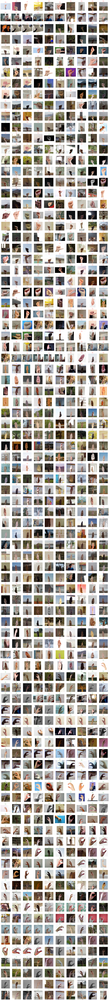

In [12]:
afficher_toutes_les_predictions(images_test, labels_test, model_ptr)

In [13]:

def get_array(ptr_func, len_func, model_ptr):
    """
    Convertit un pointeur + longueur retournés par FFI Rust en array numpy.
    """
    ptr = ptr_func(model_ptr)
    length = len_func(model_ptr)
    return np.ctypeslib.as_array(ptr, shape=(length,))


In [14]:
train_losses = get_array(lib.get_tanh_mse_losses_ptr, lib.get_tanh_mse_losses_len, model_ptr)
test_losses = get_array(lib.get_tanh_mse_test_losses_ptr, lib.get_tanh_mse_test_losses_len, model_ptr)

train_accs = get_array(lib.get_tanh_mse_train_accuracies_ptr, lib.get_tanh_mse_train_accuracies_len, model_ptr)
test_accs = get_array(lib.get_tanh_mse_test_accuracies_ptr, lib.get_tanh_mse_test_accuracies_len, model_ptr)


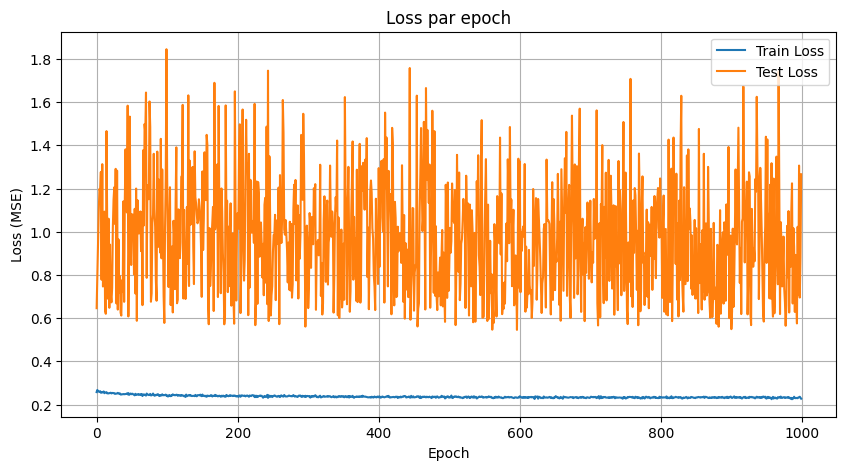

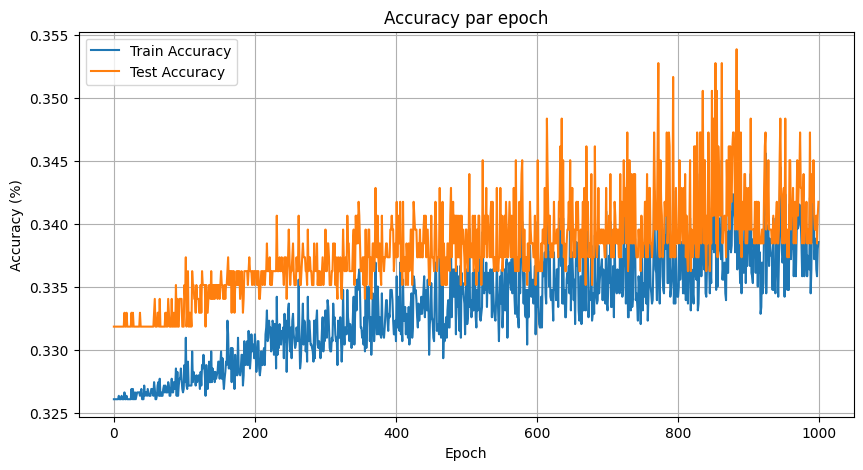

In [15]:
# --- Loss ---
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Train Loss')
plt.plot(test_losses, label='Test Loss')
plt.title("Loss par epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss (MSE)")
plt.legend()
plt.grid(True)
plt.show()

# --- Accuracy ---
plt.figure(figsize=(10, 5))
plt.plot(train_accs, label='Train Accuracy')
plt.plot(test_accs, label='Test Accuracy')
plt.title("Accuracy par epoch")
plt.xlabel("Epoch")
plt.ylabel("Accuracy (%)")
plt.legend()
plt.grid(True)
plt.show()
